In [11]:
import numpy as np
import scipy
import time
import heapq
import pandas as pd
import math
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from os import listdir, walk
from os.path import isfile, join
import os
import json
%pylab inline

Populating the interactive namespace from numpy and matplotlib


### Visualization

In [237]:
is_nab = True

root = '../../data/data_nab/' if is_nab else '../../data/data_yahoo/'
root_l = '../../data/labels/combined_labels.json' if is_nab else '../../data/labels/yahoo_labels.json'
root_w = '../../data/labels/combined_windows.json' if is_nab else '../../data/labels/yahoo_windows.json'

labels = json.load(open(root_l,'r'))
windows = json.load(open(root_w,'r'))

pattern = '%Y-%m-%d %H:%M:%S'
to_int = lambda x: int(time.mktime(time.strptime(x, pattern)))

def plotting_path(i_path):
    path = root + [d for d in listdir(root) if '.' not in d][i_path] + '/'
    n_files = len([f for f in listdir(path) if not f.startswith('.')])
    plt.figure(figsize=(12, 2.7*n_files))
    for i in range(n_files):
        plotting_item(i_path, i, plt.subplot(n_files, 1, i+1))
    plt.tight_layout()

    
def plotting_ts(i_path, i_ts):
    plt.figure(figsize=(12,3))
    plotting_item(i_path, i_ts, plt.subplot(1,1,1))
    
def plotting_item(i_path, i_ts, ax):
    path = [d for d in listdir(root) if '.' not in d][i_path] + '/'
    file_name = path+[f for f in listdir(root+path) if not f.startswith('.')][i_ts]
    plt.title(file_name)
    df = pd.read_csv(root+file_name)
    
    csv = df
    x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
    y = list(csv['value'])

    ax.plot(x, y)
    ax.axis('tight')
    # plot anomalies
    index = [list(csv['timestamp']).index(lab) for lab in labels[file_name]]
    ax.plot([x[j] for j in index], [y[j] for j in index], 'vr', markersize=10)


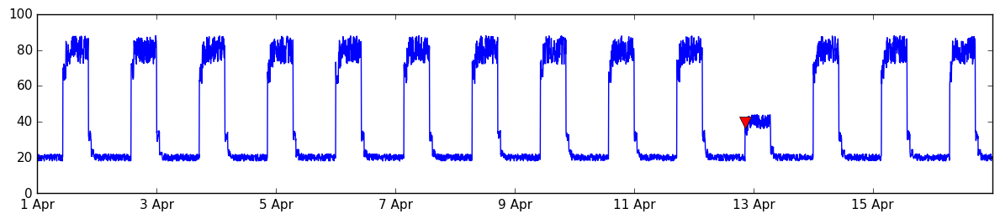

In [196]:
# figs_index = [(1,1), (4,4), (5,1), (5,4), (6,5)]
x_ticks_names = ['1 Apr', '3 Apr', '5 Apr', '7 Apr', '9 Apr', '11 Apr', '13 Apr', '15 Apr']
i_path = 1
i_ts = 1

plt.figure(figsize=(12, 2.7))
ax = plt.gca()

path = [d for d in listdir(root) if '.' not in d][i_path] + '/'
file_name = path+[f for f in listdir(root+path) if not f.startswith('.')][i_ts]
# plt.title(file_name)
df = pd.read_csv(root+file_name)

csv = df
x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
y = list(csv['value'])

ax.plot(x, y)
ax.axis('tight')
ax.set_ylim((.0,100))
# plot anomalies
index = [list(csv['timestamp']).index(lab) for lab in labels[file_name]]
ax.plot([x[j] for j in index], [y[j] for j in index], 'vr', markersize=10)

x_ticks = np.linspace(min(x), max(x), len(x_ticks)).astype(int)
plt.xticks(x_ticks, x_ticks_names, fontsize=11);
plt.yticks(fontsize=11)
plt.tight_layout()
plt.savefig('Pictures/synthetic.png', bbox_inches='tight', dpi=600)

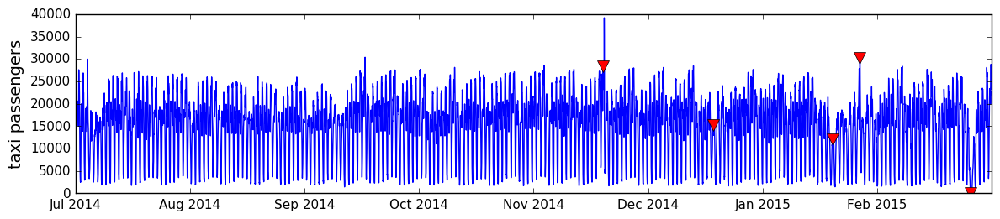

In [238]:
# figs_index = [(1,1), (4,4), (5,1), (5,4), (6,5)]
x_ticks_names = ['Jul 2014', 'Aug 2014', 'Sep 2014', 'Oct 2014', 'Nov 2014', 'Dec 2014', 'Jan 2015', 'Feb 2015']
i_path = 4
i_ts = 4

plt.figure(figsize=(12, 2.7))
ax = plt.gca()

path = [d for d in listdir(root) if '.' not in d][i_path] + '/'
file_name = path+[f for f in listdir(root+path) if not f.startswith('.')][i_ts]
# plt.title(file_name)
df = pd.read_csv(root+file_name)

csv = df
x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
y = list(csv['value'])

ax.plot(x, y)
ax.axis('tight')
ax.set_ylim((.0,40000))
# plot anomalies
index = [list(csv['timestamp']).index(lab) for lab in labels[file_name]]
ax.plot([x[j] for j in index], [y[j] for j in index], 'vr', markersize=10)

x_ticks = np.linspace(min(x), max(x), len(x_ticks)).astype(int)
# print(csv['timestamp'])
plt.ylabel('taxi passengers', fontsize=14);

plt.xticks(x_ticks, x_ticks_names, fontsize=11);
plt.yticks(fontsize=11)
plt.tight_layout()
plt.savefig('Pictures/nyc_taxi.png', bbox_inches='tight', dpi=600)

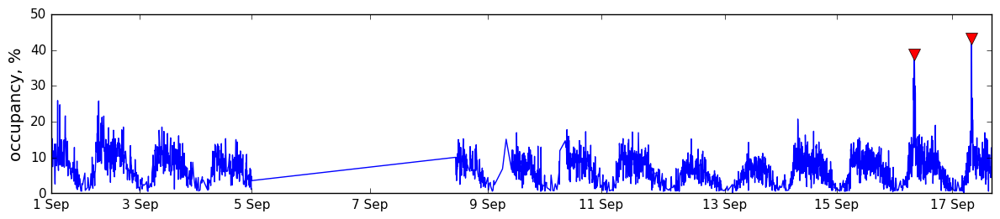

In [209]:
# figs_index = [(1,1), (4,4), (5,1), (5,4), (6,5)]
x_ticks_names = ['1 Sep', '3 Sep', '5 Sep', '7 Sep', '9 Sep', '11 Sep', '13 Sep', '15 Sep', '17 Sep']
i_path = 5
i_ts = 1

plt.figure(figsize=(12, 2.7))
ax = plt.gca()

path = [d for d in listdir(root) if '.' not in d][i_path] + '/'
file_name = path+[f for f in listdir(root+path) if not f.startswith('.')][i_ts]
# plt.title(file_name)
df = pd.read_csv(root+file_name)

csv = df
x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
y = list(csv['value'])

ax.plot(x, y)
ax.axis('tight')
ax.set_ylim((.0,50))
# plot anomalies
index = [list(csv['timestamp']).index(lab) for lab in labels[file_name]]
ax.plot([x[j] for j in index], [y[j] for j in index], 'vr', markersize=10)

x_ticks = [x[0], x[299], x[640], (x[640]+x[743])/2, x[743], x[1041], x[1450], x[1848], x[2332]]
# print(csv['timestamp'])
plt.ylabel('occupancy, %', fontsize=14);
plt.xticks(x_ticks, x_ticks_names, fontsize=11);
plt.yticks(fontsize=11)
plt.tight_layout()
plt.savefig('Pictures/NAB/nab_occupancy.png', bbox_inches='tight', dpi=600)


2015-09-01 11:25:00


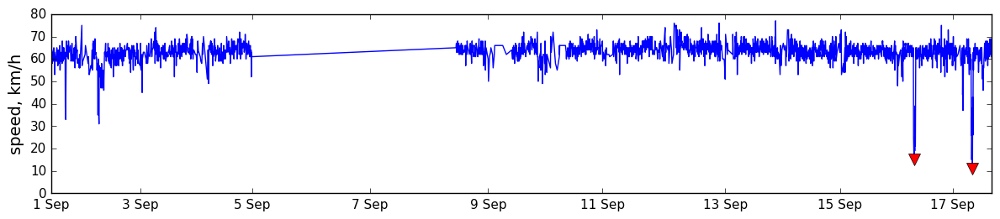

In [211]:
# figs_index = [(1,1), (4,4), (5,1), (5,4), (6,5)]
x_ticks_names = ['1 Sep', '3 Sep', '5 Sep', '7 Sep', '9 Sep', '11 Sep', '13 Sep', '15 Sep', '17 Sep']
i_path = 5
i_ts = 4

plt.figure(figsize=(12, 2.7))
ax = plt.gca()

path = [d for d in listdir(root) if '.' not in d][i_path] + '/'
file_name = path+[f for f in listdir(root+path) if not f.startswith('.')][i_ts]
# plt.title(file_name)
df = pd.read_csv(root+file_name)

csv = df
x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
y = list(csv['value'])

ax.plot(x, y)
ax.axis('tight')
ax.set_ylim((.0,80))
# plot anomalies
index = [list(csv['timestamp']).index(lab) for lab in labels[file_name]]
ax.plot([x[j] for j in index], [y[j] for j in index], 'vr', markersize=10)

x_ticks = [x[0], x[299], x[640], (x[640]+x[743])/2, x[743], x[1041], x[1450], x[1848], x[2332]]
print(csv['timestamp'][0])
plt.ylabel('speed, km/h', fontsize=14);
plt.xticks(x_ticks, x_ticks_names, fontsize=11);
plt.yticks(fontsize=11)
plt.tight_layout()
# plt.savefig('Pictures/speed.png', bbox_inches='tight', dpi=600)


2015-02-26 21:42:53


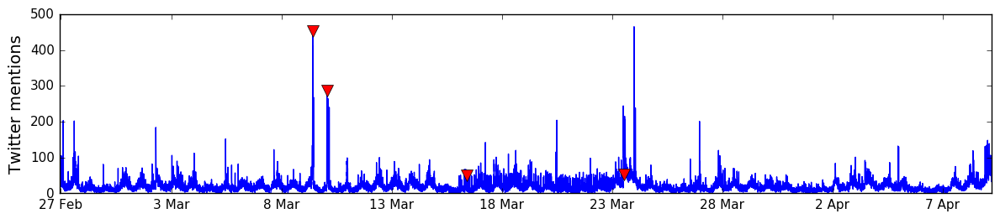

In [212]:
# figs_index = [(1,1), (4,4), (5,1), (5,4), (6,5)]
x_ticks_names = ['27 Feb','3 Mar','8 Mar','13 Mar','18 Mar','23 Mar','28 Mar','2 Apr','7 Apr','12 Apr','17 Apr','22 Apr']
i_path = 6
i_ts = 5

plt.figure(figsize=(12, 2.7))
ax = plt.gca()

path = [d for d in listdir(root) if '.' not in d][i_path] + '/'
file_name = path+[f for f in listdir(root+path) if not f.startswith('.')][i_ts]
# plt.title(file_name)
df = pd.read_csv(root+file_name)

csv = df
x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
y = list(csv['value'])

ax.plot(x, y)
ax.axis('tight')
ax.set_ylim((.0,500))
# plot anomalies
index = [list(csv['timestamp']).index(lab) for lab in labels[file_name]]
ax.plot([x[j] for j in index], [y[j] for j in index], 'vr', markersize=10)

x_ticks = np.linspace(x[28], x[15004], len(x_ticks)).astype(int)
print(csv['timestamp'][0])
plt.ylabel('Twitter mentions', fontsize=14);
plt.xticks(x_ticks, x_ticks_names, fontsize=11);
plt.yticks(fontsize=11)
plt.tight_layout()
plt.savefig('Pictures/tweeter.png', bbox_inches='tight', dpi=600)


In [ ]:
####################
#################### 
####################

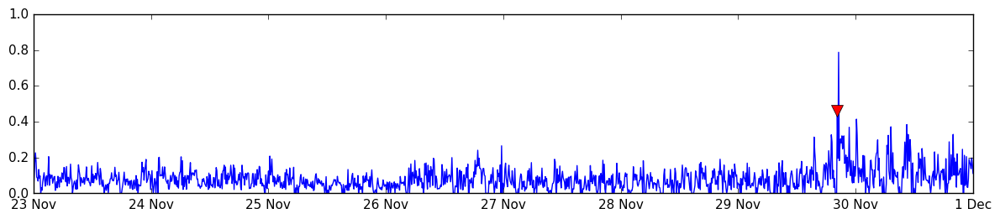

In [221]:
# figs_index = [(0,0), (0,-6), (0,-3), (2,-4), (3,-1)]
x_ticks_names = ['23 Nov','24 Nov','25 Nov','26 Nov','27 Nov','28 Nov','29 Nov','30 Nov','1 Dec']
x_ticks = np.linspace(x[0], x[-1], len(x_ticks)).astype(int)

i_path = 0
i_ts = 0

plt.figure(figsize=(12, 2.7))
ax = plt.gca()

path = [d for d in listdir(root) if '.' not in d][i_path] + '/'
file_name = path+[f for f in listdir(root+path) if not f.startswith('.')][i_ts]
# plt.title(file_name)
df = pd.read_csv(root+file_name)

csv = df
x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
y = list(csv['value'])

ax.plot(x, y)
ax.axis('tight')
ax.set_ylim((.0,1.))
# plot anomalies
index = [list(csv['timestamp']).index(lab) for lab in labels[file_name]]
ax.plot([x[j] for j in index], [y[j] for j in index], 'vr', markersize=10)


# print(csv['timestamp'])
plt.xticks(x_ticks, x_ticks_names, fontsize=11);
plt.yticks(fontsize=11)
plt.tight_layout()
plt.savefig('Pictures/Yahoo/yahoo_real1.png', bbox_inches='tight', dpi=600)


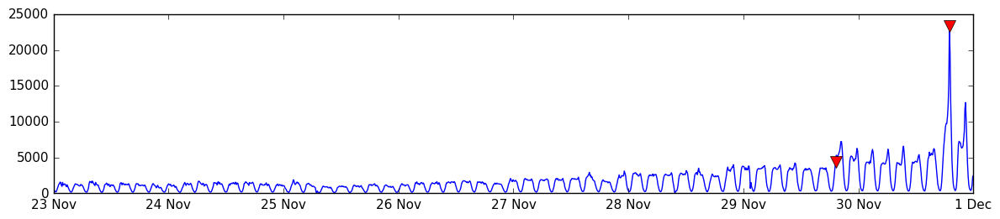

In [224]:
# figs_index = [(0,0), (0,-6), (0,-3), (2,-4), (3,-1)]
x_ticks_names = ['23 Nov','24 Nov','25 Nov','26 Nov','27 Nov','28 Nov','29 Nov','30 Nov','1 Dec']
i_path = 0
i_ts = -6

plt.figure(figsize=(12, 2.7))
ax = plt.gca()

path = [d for d in listdir(root) if '.' not in d][i_path] + '/'
file_name = path+[f for f in listdir(root+path) if not f.startswith('.')][i_ts]
# plt.title(file_name)
df = pd.read_csv(root+file_name)

csv = df
x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
y = list(csv['value'])

ax.plot(x, y)
ax.axis('tight')
ax.set_ylim((.0,25000.))
# plot anomalies
index = [list(csv['timestamp']).index(lab) for lab in labels[file_name]]
ax.plot([x[j] for j in index], [y[j] for j in index], 'vr', markersize=10)

x_ticks = np.linspace(x[0], x[-1], len(x_ticks)).astype(int)
# print(csv['timestamp'])
plt.xticks(x_ticks, x_ticks_names, fontsize=11);
plt.yticks(fontsize=11)
plt.tight_layout()
plt.savefig('Pictures/Yahoo/yahoo_real2.png', bbox_inches='tight', dpi=600)


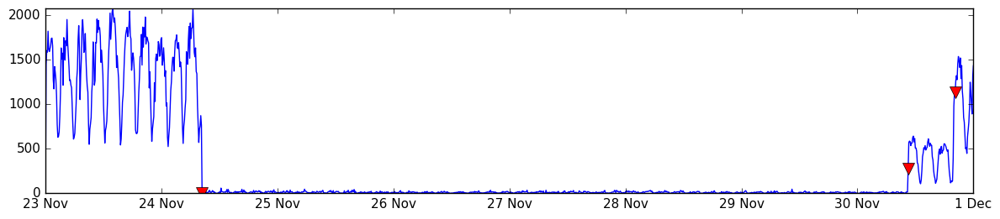

In [226]:
# figs_index = [(0,0), (0,-6), (0,-3), (2,-4), (3,-1)]
x_ticks_names = ['23 Nov','24 Nov','25 Nov','26 Nov','27 Nov','28 Nov','29 Nov','30 Nov','1 Dec']
i_path = 0
i_ts = -3

plt.figure(figsize=(12, 2.7))
ax = plt.gca()

path = [d for d in listdir(root) if '.' not in d][i_path] + '/'
file_name = path+[f for f in listdir(root+path) if not f.startswith('.')][i_ts]
# plt.title(file_name)
df = pd.read_csv(root+file_name)

csv = df
x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
y = list(csv['value'])

ax.plot(x, y)
ax.axis('tight')
# ax.set_ylim((.0,25000.))
# plot anomalies
index = [list(csv['timestamp']).index(lab) for lab in labels[file_name]]
ax.plot([x[j] for j in index], [y[j] for j in index], 'vr', markersize=10)

x_ticks = np.linspace(x[0], x[-1], len(x_ticks)).astype(int)
# print(csv['timestamp'])
plt.xticks(x_ticks, x_ticks_names, fontsize=11);
plt.yticks(fontsize=11)
plt.tight_layout()
plt.savefig('Pictures/Yahoo/yahoo_real3.png', bbox_inches='tight', dpi=600)


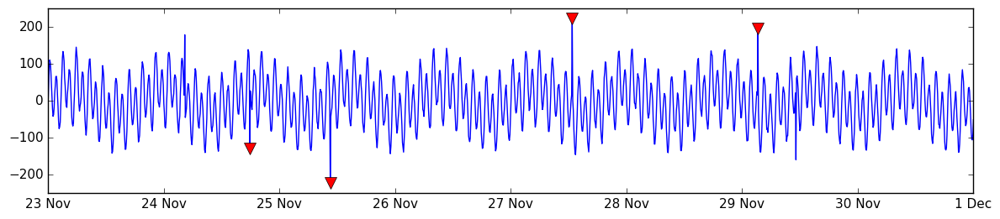

In [231]:
# figs_index = [(0,0), (0,-6), (0,-3), (2,-4), (3,-1)]
x_ticks_names = ['23 Nov','24 Nov','25 Nov','26 Nov','27 Nov','28 Nov','29 Nov','30 Nov','1 Dec']
i_path = 2
i_ts = -4

plt.figure(figsize=(12, 2.7))
ax = plt.gca()

path = [d for d in listdir(root) if '.' not in d][i_path] + '/'
file_name = path+[f for f in listdir(root+path) if not f.startswith('.')][i_ts]
# plt.title(file_name)
df = pd.read_csv(root+file_name)

csv = df
x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
y = list(csv['value'])

ax.plot(x, y)
ax.axis('tight')
ax.set_ylim((-250,250.))
# plot anomalies
index = [list(csv['timestamp']).index(lab) for lab in labels[file_name]]
ax.plot([x[j] for j in index], [y[j] for j in index], 'vr', markersize=10)

x_ticks = np.linspace(x[0], x[-1], len(x_ticks)).astype(int)
# print(csv['timestamp'])
plt.xticks(x_ticks, x_ticks_names, fontsize=11);
plt.yticks(fontsize=11)
plt.tight_layout()
plt.savefig('Pictures/Yahoo/yahoo_synthetic1.png', bbox_inches='tight', dpi=600)


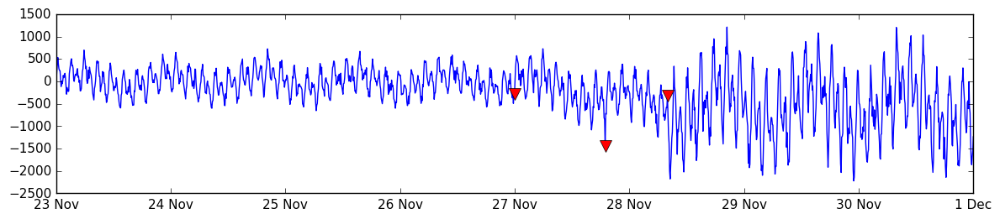

In [235]:
# figs_index = [(0,0), (0,-6), (0,-3), (2,-4), (3,-1)]
x_ticks_names = ['23 Nov','24 Nov','25 Nov','26 Nov','27 Nov','28 Nov','29 Nov','30 Nov','1 Dec']
i_path = 3
i_ts = -1

plt.figure(figsize=(12, 2.7))
ax = plt.gca()

path = [d for d in listdir(root) if '.' not in d][i_path] + '/'
file_name = path+[f for f in listdir(root+path) if not f.startswith('.')][i_ts]
# plt.title(file_name)
df = pd.read_csv(root+file_name)

csv = df
x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
y = list(csv['value'])

ax.plot(x, y)
ax.axis('tight')
ax.set_ylim((-2500.0,1500.))
# plot anomalies
index = [list(csv['timestamp']).index(lab) for lab in labels[file_name]]
ax.plot([x[j] for j in index], [y[j] for j in index], 'vr', markersize=10)

x_ticks = np.linspace(x[0], x[-1], len(x_ticks)).astype(int)
# print(csv['timestamp'])
plt.xticks(x_ticks, x_ticks_names, fontsize=11);
plt.yticks(fontsize=11)
plt.tight_layout()
plt.savefig('Pictures/Yahoo/yahoo_synthetic2.png', bbox_inches='tight', dpi=600)


## Plotting

In [21]:
mypath = [f for f in listdir('.') if not isfile(f) and not '.' in f ]
labels, windows = None, None
with open('../labels/yahoo_labels.json') as data_file:    
    labels = json.load(data_file)
with open('../labels/yahoo_windows.json') as data_file:    
    windows = json.load(data_file)
    
pattern = '%Y-%m-%d %H:%M:%S'
to_int = lambda x: int(time.mktime(time.strptime(x, pattern)))

def plotting_nab(path, num=None):
    print(path)
    onlyfiles = None
    if num is None:
        onlyfiles = [f for f in listdir(path) if isfile(join(path, f))]
    else:
        onlyfiles = [f for f in listdir(path) if isfile(join(path, f))][:num]
    fig = plt.figure(figsize=(20,3*len(onlyfiles)))
    for i in range(len(onlyfiles)):
        if not onlyfiles[i].endswith('.csv'):
            continue
        csv = pd.read_csv(path+'/'+onlyfiles[i])
        x = [to_int(tm)- to_int(csv['timestamp'][0]) for tm in list(csv['timestamp'])]
        x_15 = x[int(len(x)*15/100)]
        y = list(csv['value'])

        ax = fig.add_subplot(len(onlyfiles), 1, i+1)#, ylabel=onlyfiles[i])
        ax.plot(x, y)
        ax.axis('tight')
        # plot anomaly window
        ax.add_patch(patches.Rectangle((x[0], min(y)), x_15-x[0], max(y)-min(y),alpha=0.1))
        for wind in windows[path+'/'+onlyfiles[i]]:
            begin = to_int(wind[0].split('.')[0]) - to_int(csv['timestamp'][0])
            end = to_int(wind[1].split('.')[0])-to_int(csv['timestamp'][0])
            ax.add_patch(patches.Rectangle((begin, min(y)), end-begin, max(y)-min(y),alpha=0.1, color='red'))
        # plot anomalies
        index = [list(csv['timestamp']).index(lab) for lab in labels[path+'/'+onlyfiles[i]]]
        ax.plot([x[i] for i in index], [y[i] for i in index], 'or')
        
#     _=plt.xlabel(path, size=20)

A1_yahoo


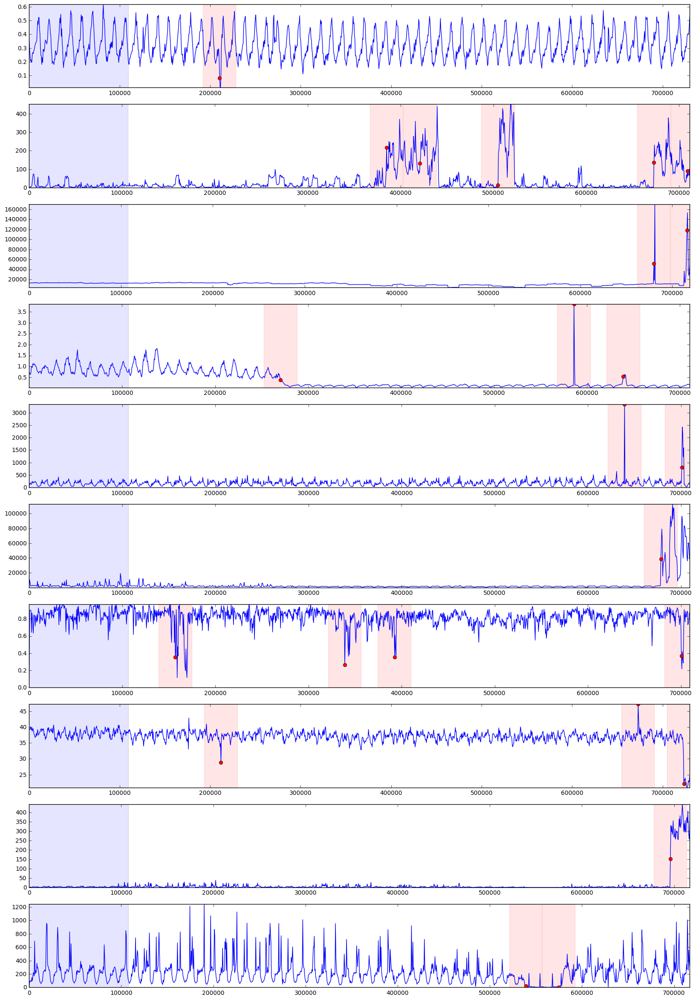

In [22]:
plotting_nab(mypath[0], num=20)

A2_yahoo


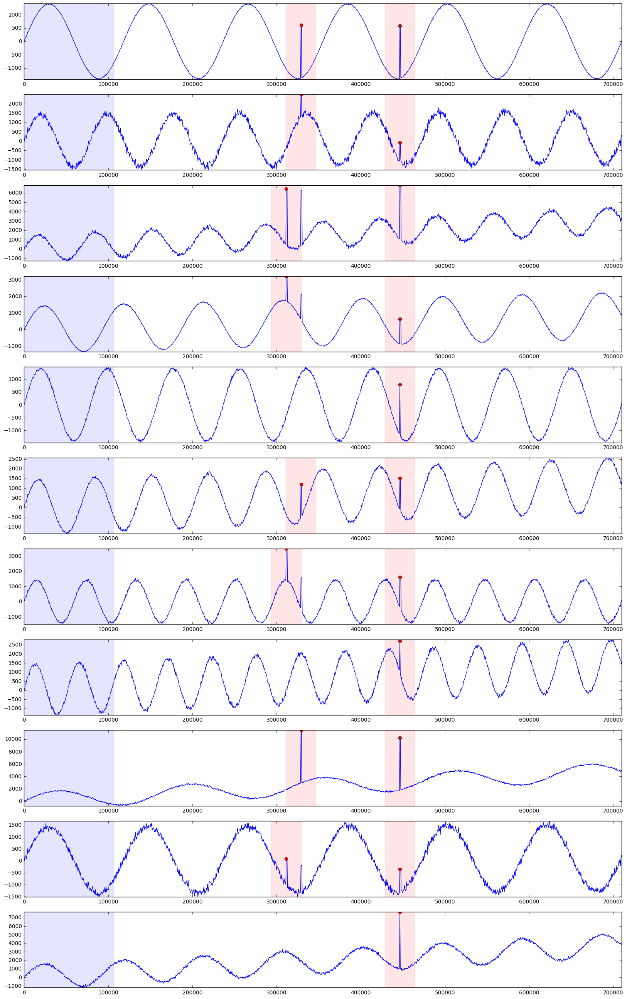

In [15]:
plotting_nab(mypath[1], 40)

A3_yahoo


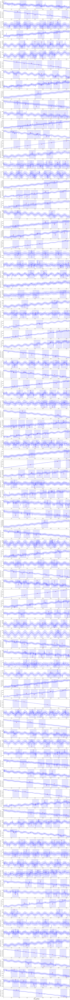

In [18]:
plotting_nab(mypath[2])

A4_yahoo


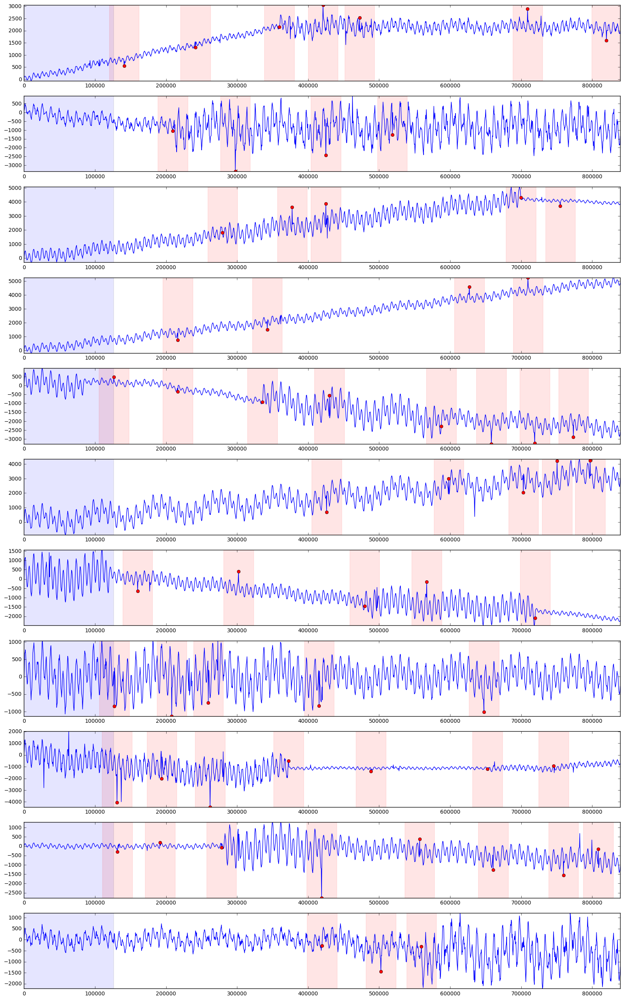

In [16]:
plotting_nab(mypath[3], 30)

## Plotting (deprecated)

In [ ]:
def plotting(path):
    print(path)
    onlyfiles = [f for f in listdir(path) if isfile(join(path, f))]
    fig = plt.figure(figsize=(20,5*len(onlyfiles)))
    for i in range(len(onlyfiles)):
        if not onlyfiles[i].endswith('.csv'):
            continue
        csv = pd.read_csv(path+'/'+onlyfiles[i])
        x = list(csv.timestamp)
        y = list(csv.value)

        ax = fig.add_subplot(len(onlyfiles), 1, i+1, ylabel=onlyfiles[i])
        ax.plot(x, y)
        ax.axis('tight')
        
        # plot anomalies
        index = list(csv[csv.is_anomaly == 1].index)
        ax.plot([x[i] for i in index], [y[i] for i in index], 'or')
        
    _=plt.xlabel(path, size=20)

A1Benchmark


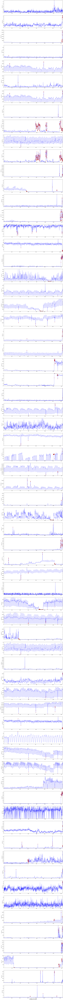

In [61]:
plotting("A1Benchmark")

A2Benchmark


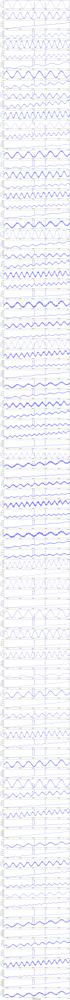

In [59]:
plotting("A2Benchmark")

In [97]:
def plotting34(path, value='value'):
    print(path)
    onlyfiles = [f for f in listdir(path) if isfile(join(path, f))]
    fig = plt.figure(figsize=(20,5*len(onlyfiles)))
    for i in range(min(20,len(onlyfiles))):
        if not onlyfiles[i].endswith('.csv'):
            continue
        csv = pd.read_csv(path+'/'+onlyfiles[i])
        x = list(csv.timestamps)
        y = list(csv[value])

        ax = fig.add_subplot(len(onlyfiles), 1, i+1, ylabel=onlyfiles[i])
        ax.plot(x, y)
        ax.axis('tight')
        
        # plot anomalies
        index = list(csv[csv.anomaly == 1].index)
        ax.plot([x[i] for i in index], [y[i] for i in index], 'or')
        # plot changepoints
        for i in list(csv[csv.changepoint == 1].index):
            plt.axvline(x=x[i],color='g', linestyle='--',linewidth=4)
        
    _=plt.xlabel(path, size=20)


# pd.read_csv("A4Benchmark/A4Benchmark-TS10.csv").describe()

A4Benchmark


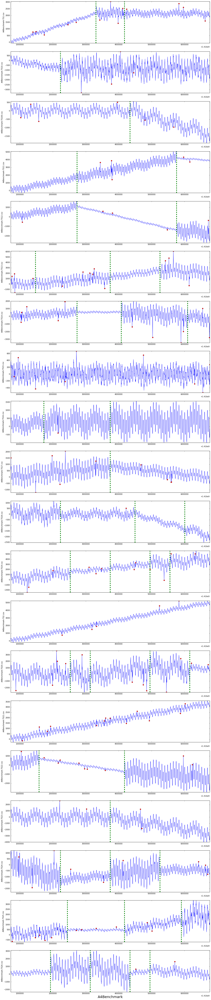

In [99]:
plotting34("A4Benchmark")